# Sonification of DOS band centre

## Overview

This notebook explores the sonification of molecular dynamics data using the [Strauss](https://www.audiouniverse.org/research/strauss) software package. 

Phonons are quantum mechanical vibrations. A phonon mode is animated below. There are $3N-3$ phonon modes in a material with $N$ atoms in the unit cell. They superimpose on top of one another to describe the complex vibration of a crystal.

In the dataset we explore here the forces which define the phonon are calculated using quantum chemistry. This provides us with high-accuracy predictions of the material thermal properties.

We will use sonification to listen to the vibrations of the material; we will hear how they sing.



<img src="../assets/img/M-mode.gif" width="250" align="center">

## **1. Setup:**



You will need to install `strauss` if you have not done so already.

Make plots appear in-line by default

In [1]:
%matplotlib inline

Import the modules we need...

In [2]:
# strauss imports
from strauss.sonification import Sonification
from strauss.sources import Events, Objects
from strauss import channels
from strauss.score import Score
from strauss.generator import Sampler, Synthesizer, Spectralizer
from strauss import sources as Sources
import strauss

# other standard scientific Python modules
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import itertools

# modules to display in-notebook
import IPython.display as ipd
from IPython.display import display, Markdown, Latex, Image

import sys
sys.path.append('../')
from phonon_sonification import MP_interface
from phonon_sonification import phonon_frequency_mapping

# set figures to be a decent size by default
import matplotlib
font = {'family' : 'sans-serif',
        'weight' : 'normal',
        'size'   : 18}
matplotlib.rc('font', **font)
matplotlib.rc('figure', **{'figsize':[14.0, 7.0]})

## DOS band centre frequency mapping

In [25]:
Cs3Sb_data = MP_interface.dos_stats_analysis("mp-10378",temp=list(np.arange(1,100,1)))
data_table = MP_interface.dos_dict_to_dataframe(Cs3Sb_data)
print(data_table.head())

There are 22 imaginary frequencies which have not been processed
      mp_id site  temperature   band_centre  integrated_dos   quantile_25  \
0  mp-10378  all          NaN  2.006263e+12    1.076006e+13  1.475450e+12   
1  mp-10378  all          1.0  4.020732e+10    3.644448e+09  1.910366e+10   
2  mp-10378  all          2.0  6.450851e+10    1.638163e+10  1.910366e+10   
3  mp-10378  all          3.0  8.641062e+10    3.650736e+10  1.910366e+10   
4  mp-10378  all          4.0  1.054891e+11    6.256100e+10  1.910366e+10   

    quantile_75           IQR  
0  2.578230e+12  1.102781e+12  
1  1.910366e+10  0.000000e+00  
2  4.892182e+10  2.981816e+10  
3  7.943056e+10  6.032690e+10  
4  1.073829e+11  8.827927e+10  


First we will try sonifying this by mapping each of the projected band centres to a note.

In [32]:
mapped_f = {}

for projection in ['Cs_1','Cs_2','Cs_3','Sb_1']:


    f_ph = float(data_table[
        (data_table["site"] == projection) &
        (data_table["temperature"]== 1.0)]["band_centre"])
    fmin_ph = min(data_table[
        (data_table["temperature"]== 1.0)]["band_centre"])
    fmax_ph = max(data_table[
        (data_table["temperature"]== 99.0)]["band_centre"])

    mapped_f[projection] = phonon_frequency_mapping.phonon_to_note(f_ph/1E12,fmin_ph/1E12,fmax_ph/1E12)

/var/folders/ny/5knc_9j57gx54mx6yn23ds200000gp/T/ipykernel_81931/3444479237.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f_ph = float(data_table[


In [33]:
mapped_f

{'Cs_1': {'phonon_frequency': 0.04021805020032388,
  'audible_frequency': 200.07372993898582,
  'note': 'G',
  'octave': 3,
  'note-octave': 'G3'},
 'Cs_2': {'phonon_frequency': 0.04021805020032389,
  'audible_frequency': 200.07372993898582,
  'note': 'G',
  'octave': 3,
  'note-octave': 'G3'},
 'Cs_3': {'phonon_frequency': 0.040277668908541224,
  'audible_frequency': 200.09165604765653,
  'note': 'G',
  'octave': 3,
  'note-octave': 'G3'},
 'Sb_1': {'phonon_frequency': 0.03997278275892066,
  'audible_frequency': 200.0,
  'note': 'G',
  'octave': 3,
  'note-octave': 'G3'}}

/var/folders/ny/5knc_9j57gx54mx6yn23ds200000gp/T/ipykernel_81931/1352363448.py:31: UserWarning: Specifying percentiles without appending a '%' character (e.g. XX%) currently works but is deprecated for more explicit syntax.
  sources.apply_mapping_functions(map_lims=lims)


D6 <class 'str'>


100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 10.85it/s]


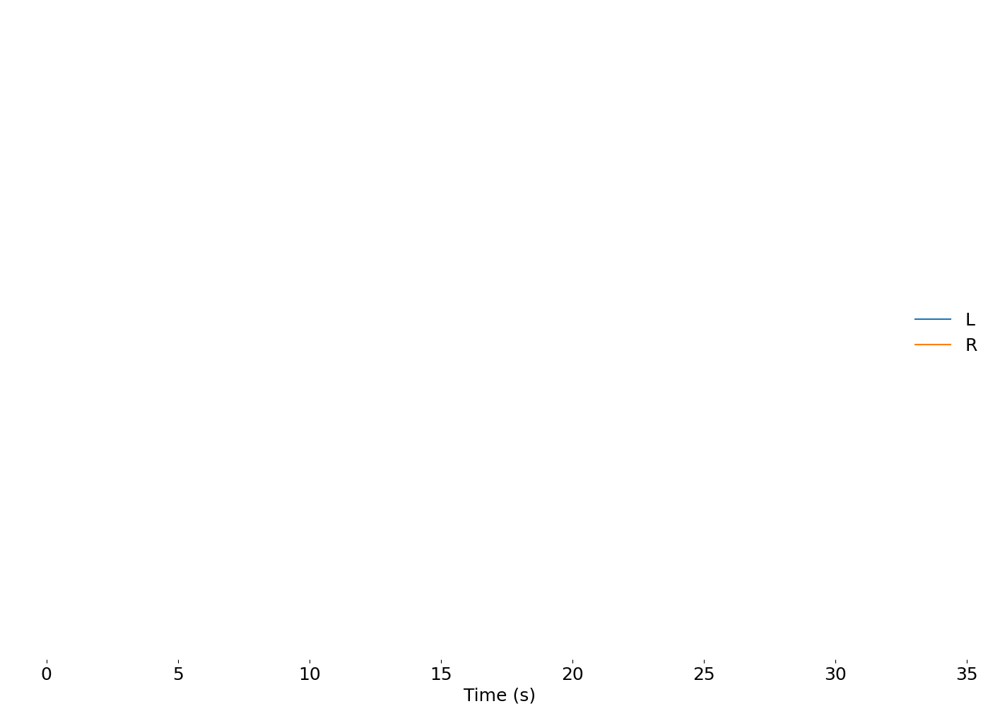

In [24]:
# some strauss setup can happen outside the loop...
# this is for Cs_1
length = 30.0
generator = Synthesizer()
generator.load_preset('pitch_mapper')
note = mapped_f['Cs_1']['note-octave']
score =  Score(note, length)

lims = {'time_evo': ('0','100'),
        'pitch_shift': ('0','100'),
        'cutoff': ('0','100'),
        'volume':('0','100')}

data = {'pitch':[1]*20,
        'time_evo':list(np.arange(20)),
        'pitch_shift':[1]*20,
        'cutoff':[1]*20,
        'volume':[1]*20}


#data = {'pitch':1.,
#        'time_evo':x,
#        'azimuth':(x*0.5+0.25) % 1,
#        'polar':0.5,
#        'pitch_shift':y**0.7}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=lims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

Listen to the sonification [here](https://NU-CEM.github.io/play_audio?p=https://github.com/NU-CEM/Singing_Materials_Strauss/raw/refs/heads/main/assets/wav/BZS_M_continuous.wav).

## Exhaustive search for optimum mapping parameters

Now let's consider all possible combinations of the 8 evolvable parameters implemented in strauss.

For this we will consider only 2 properties being sonified at once (not including the time variable) as, due to crystal symmetry, Mx and My display similar behaviour.

For 2 properties there are 28 possible mapping combinations $\left(\frac{8!}{2!(8-2)!} = 28\right)$.

Some combinations might work better than others; an exhaustive search means cannot miss the most effective combination.

Note that the cell output has been deleted as the resulting sonifications take up a relatively large amount of memory (more than Github can handle....).

In [ ]:
# A list of some 'evolvable' mappings
some_mappings = ["pitch_shift",
                 "cutoff",
                 "volume",
                 "phi",
                 "volume_lfo/amount",
                 "volume_lfo/freq_shift",
                 "pitch_lfo/amount",
                 "pitch_lfo/freq_shift"]

def make_sonification(idx_Mx, idx_Mz):
    chosen = [some_mappings[idx_Mx],some_mappings[idx_Mz]]
    
    # use a stereo system to allow 'phi' mapping (low pan left and high pan right)
    system = "stereo"
    
    # some strauss setup can happen outside the loop...
    generator = Synthesizer()
    
    generator = Synthesizer()
    generator.modify_preset({'filter':'on',
                             "pitch_hi":-1, "pitch_lo": 1,
                             "pitch_lfo": {"use": "on",
                                           "amount":1*("pitch_lfo/freq_shift" in chosen),
                                           "freq":3*5**("pitch_lfo/freq_shift" not in chosen),
                                           "phase":0.25},
                             "volume_lfo": {"use": "on",
                                            "amount":1*("volume_lfo/freq_shift" in chosen),
                                            "freq":3*5**("volume_lfo/freq_shift" not in chosen),
                                            "phase":0}
                            })
    
    
    notes = [["A2", "E3"]]
    score =  Score(notes, length)
    
    lims = {'time_evo': ('0','100'),
            'pitch_shift': ('0','100'),
            'cutoff': ('0','100'),
            "volume": ('0','100'),
            "phi": (-0.5,1.5),
            "volume_lfo/amount": ('0','100'),
            "volume_lfo/freq_shift": ('0','100'),
            "pitch_lfo/amount": ('0','100'),
            "pitch_lfo/freq_shift": ('0','100')}
    
    display(Markdown(f"## Mapping Mx to <mark>***`{some_mappings[idx_Mx]}`***</mark> and Mz to <mark>***`{some_mappings[idx_Mz]}`***</mark>:"))
    
    # get data
    data = np.genfromtxt(file, delimiter=',')[1:]
    temp = data[:,1]
    Mx = data[:,3]
    Mz = data[:,5]
    
    data = {'pitch':[0,1],
          'time_evo':[temp]*2,
          'theta':[0.5]*2,
          some_mappings[idx_Mx]:[(Mx - Mx.min())/(Mx.max()-Mx.min())]*2,
          some_mappings[idx_Mz]:[(Mz - Mz.min())/(Mz.max()-Mz.min())]*2}
    
    # set up source
    sources = Objects(data.keys())
    sources.fromdict(data)
    plims = {'cutoff': (0.4,1)}
    sources.apply_mapping_functions(map_lims=lims, param_lims=plims)
    
    soni = Sonification(score, sources, generator, system)
    soni.render()
    dobj = soni.notebook_display()
    
    # change back in case cells are run out of order...
    generator.load_preset('pitch_mapper')

indices = list(itertools.combinations(range(0,8),r=2))

for i,j in indices:
    make_sonification(i,j)

## Data smoothing

Smoothing is commonly applied to data in order to simplify patterns and highlight particular trends. 

In [38]:
def smooth_data(data, window_size):
    series = pd.Series(data)
    new_data = series.rolling(window_size, win_type='boxcar', center=True, min_periods=1).mean()
    return np.array(new_data)

In [41]:
Mx_smooth = smooth_data(data_table[Mx], 2000)
My_smooth = smooth_data(data_table[My], 2000)
Mz_smooth = smooth_data(data_table[Mz], 2000)
temp_smooth = smooth_data(data_table[temp],2000)

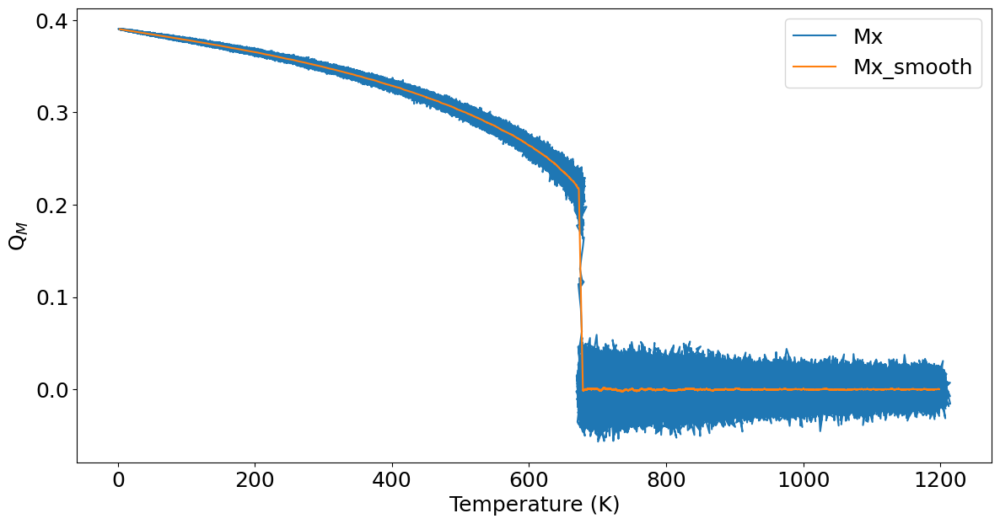

In [12]:
plt.plot(data_table[temp], data_table[Mz], label='Mx')
plt.plot(temp_smooth, Mz_smooth,label='Mx_smooth')
plt.legend()
plt.xlabel('Temperature (K)')
plt.ylabel(r'Q$_M$')
plt.show()

100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.48it/s]


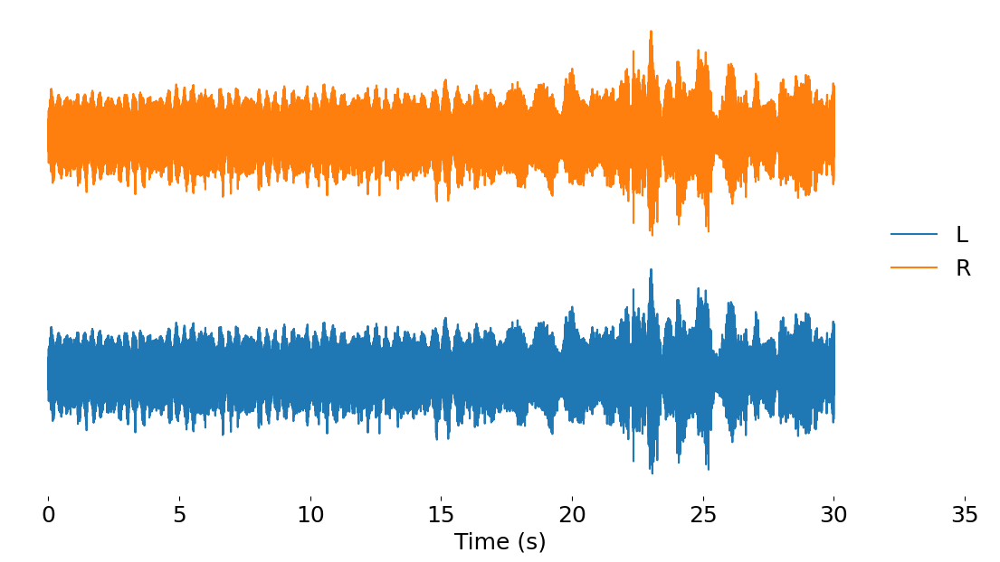

In [42]:
data = {'pitch':[0,1],
        'time_evo':[temp_smooth]*2,
        'pitch_shift':[Mz_smooth]*2,
        'cutoff':[Mx_smooth]*2,
        'volume':[My_smooth]*2}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
plims = {'cutoff': (0.3,0.9)}
sources.apply_mapping_functions(map_lims=lims, param_lims=plims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

Listen to the sonification [here](https://NU-CEM.github.io/play_audio?p=https://github.com/NU-CEM/Singing_Materials_Strauss/raw/refs/heads/main/assets/wav/BZS_M_continuous_smoothed.wav).


Now applying the `pitch_mapper` synthesiser preset for comparison.

100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  5.53it/s]


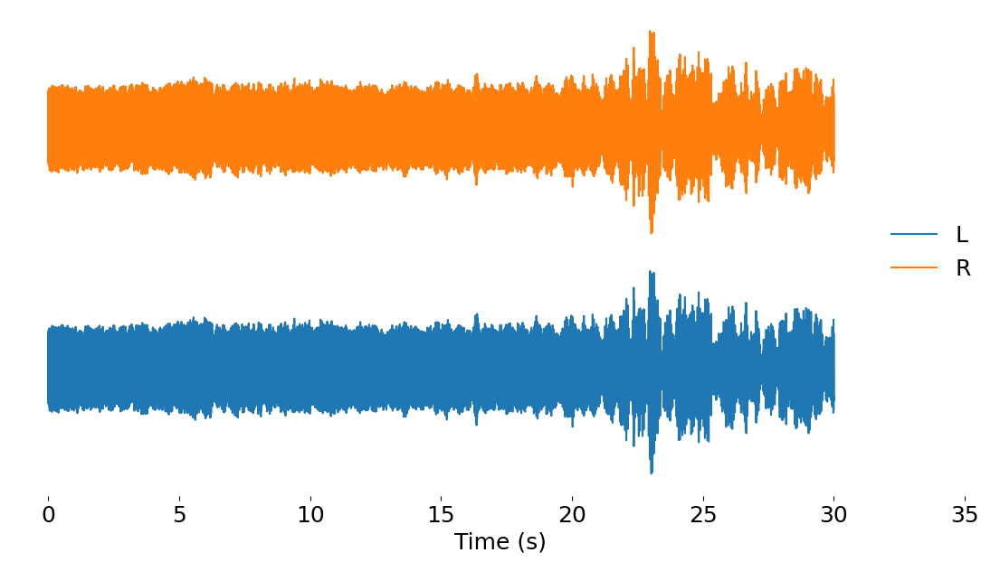

In [43]:
generator.load_preset('pitch_mapper')

data = {'pitch':[0,1],
        'time_evo':[temp_smooth]*2,
        'pitch_shift':[Mz_smooth]*2,
        'cutoff':[Mx_smooth]*2,
        'volume':[My_smooth]*2}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
plims = {'cutoff': (0.3,0.9)}
sources.apply_mapping_functions(map_lims=lims, param_lims=plims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

Listen to the sonification [here](https://NU-CEM.github.io/play_audio?p=https://github.com/NU-CEM/Singing_Materials_Strauss/raw/refs/heads/main/assets/wav/BZS_M_continuous_smoothed_pitch_mapped.wav).


In [Part Two](./Sonification_of_Octahedral_Tilts_Part_Two.ipynb) we sonify the same dataset, but now treating it as discrete data.